In [1]:
import sys
sys.path.append('../src')
from network import *
#import network as nt
#%run ../src/network.py
%run ../src/network_homology.py
import matplotlib
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline

# Network class

## Real network

In [3]:
net1 = Network()
net1.read_vertices(name = "../../data/complex_network/VertexCoordinates.txt",
                 sep = ' ')
net1.read_edges(name = "../../data/complex_network/EdgeConnectivity.txt",
                 sep = ' ')

In [4]:
print(net1)

3-D network:
Number of vertices: 18093
Number of edges: 26118


In [5]:
_ = net1.plot(segments_thickness = 1,
            segments_color = 'black',
            vertices_thickness = 0.5,
            vertices_color = 'red',
            show = True)

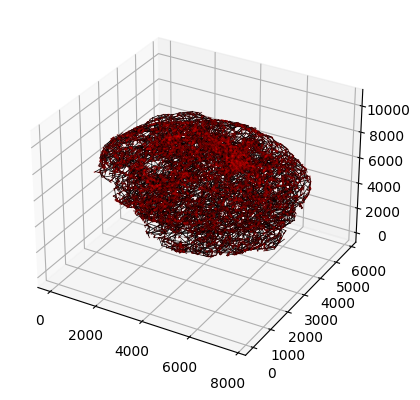

In [5]:
_ = net1.plot_static(segments_thickness = 0.5,
            segments_color = 'black',
            vertices_thickness = 0.01,
            vertices_color = 'red',
            show = True)

In [6]:
%run ../src/network_homology.py
net_hom1 = NetworkHomology(net1)

In [7]:
print(net_hom1)

Simplicial complex of dimension 1:
Number of simplices: 42042
      18093 of dimension 0
      23949 of dimension 1
1834 edges were discarded
0th Betti number: 1
1st Betti number: 5857
Interpretation: the network is composed of 1 connected components and has 5857 loops


### Alpha complex

In [8]:
alpha_complex = gd.AlphaComplex(points = net1.vertices, precision="fast")
alpha_simplex_tree = alpha_complex.create_simplex_tree()
alpha_simplex_tree.compute_persistence()

In [9]:
%run ../src/utils.py
_ = plot_simplicial_complex(
    net1.vertices,
    alpha_simplex_tree,
    filtration_value=20000,
    max_skeleton_order=10,
    points_thickness = 0.7,
    points_colour = 'midnightblue',
    segments_thickness = 0.7,
    segments_colour = 'midnightblue',
    other_color = 'salmon',
    show = True
)

#### Omologia persistente

In [29]:
alpha_barcode = alpha_simplex_tree.persistence()
alpha_barcode[0]

(2, (195757.68342266427, 466836.0978299186))

**Barcode componeti connesse**

In [11]:
barcode_0 = alpha_simplex_tree.persistence_intervals_in_dimension(0)
col=matplotlib.cm.Set1.colors[0:]
max_intervals=barcode_0.shape[0]
barcode_0.shape

(18093, 2)

usetex mode requires TeX.


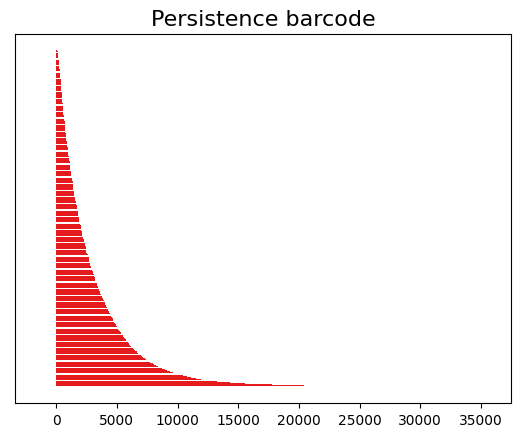

In [12]:
gd.plot_persistence_barcode(barcode_0, max_intervals=max_intervals, colormap=col,alpha=1)
plt.show()

**Barcode vuoti dimensione 1**

In [18]:
barcode_1 = alpha_simplex_tree.persistence_intervals_in_dimension(1)
col=matplotlib.cm.Set1.colors[1:]
max_intervals=barcode_1.shape[0]
barcode_1.shape

(29415, 2)

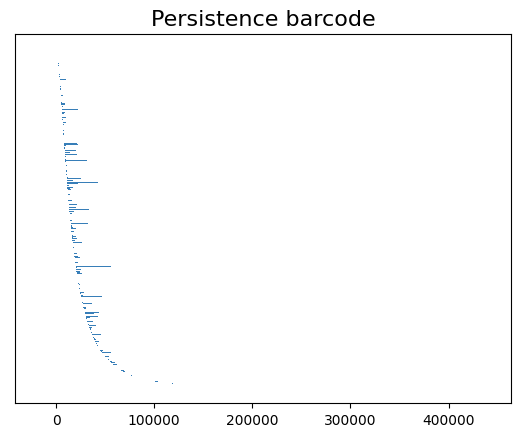

In [19]:
gd.plot_persistence_barcode(barcode_1, max_intervals=max_intervals, colormap=col,alpha=1)
plt.show()

**Barcode vuoti dimensione 2**

In [20]:
barcode_2 = alpha_simplex_tree.persistence_intervals_in_dimension(2)
col=matplotlib.cm.Set1.colors[2:]
max_intervals=barcode_2.shape[0]
barcode_2.shape

(13005, 2)

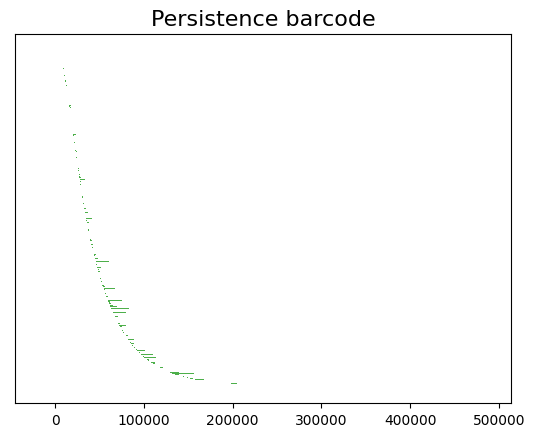

In [21]:
gd.plot_persistence_barcode(barcode_2, max_intervals=max_intervals, colormap=col,alpha=1)
plt.show()

**Diagramma di persistenza**

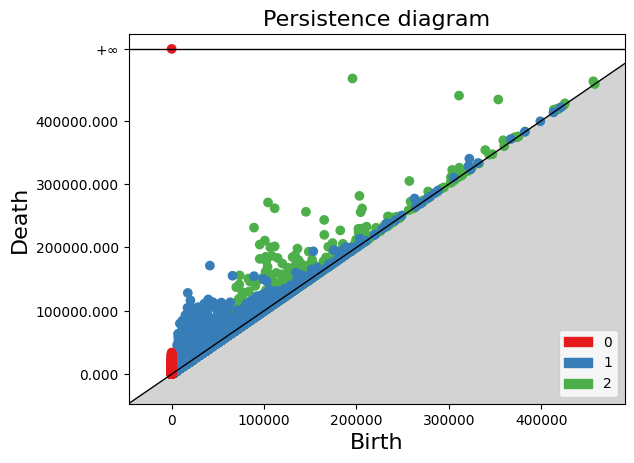

In [22]:
gd.plot_persistence_diagram(alpha_barcode,alpha=1,legend=True)
plt.show()

## Synthetic network

In [2]:
net2 = Network()
net2.read_vertices(name = "data/synthetic_network/VerticesCoordinates_negSeed0.5.txt",
                 sep = ',')
net2.read_edges(name = "data/synthetic_network/Connectivity_negSeed0.5.txt",
                 sep = ',')

In [3]:
print(net2)
print(max(net2.edges[:,1]))

2-D network:
Number of vertices: 686
Number of edges: 935
685


In [4]:
_ = net2.plot(segments_thickness = 3,
            segments_color = 'black',
            vertices_thickness = 1.5,
            vertices_color = 'red',
            show = True)

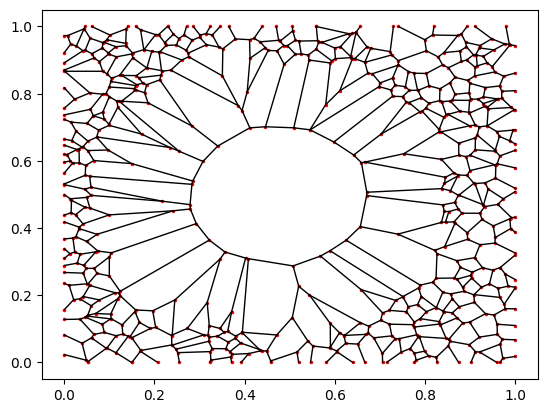

In [5]:
_ = net2.plot_static(segments_thickness = 1,
            segments_color = 'black',
            vertices_thickness = 3,
            vertices_color = 'red',
            show = True)

In [6]:
net_hom2 = NetworkHomology(net2)
print(net_hom2)

Simplicial complex of dimension 1:
Number of simplices: 1621
      686 of dimension 0
      935 of dimension 1
0 edges were discarded
0th Betti number: 1
1st Betti number: 250
Interpretation: the network is composed of 1 connected components and has 250 loops


In [7]:

alpha_complex = gd.AlphaComplex(points = net2.vertices, precision="safe")
alpha_simplex_tree = alpha_complex.create_simplex_tree()

In [8]:
%run ../src/utils.py
_ = plot_simplicial_complex(
    net2.vertices,
    alpha_simplex_tree,
    filtration_value=0.0140693,
    max_skeleton_order=10,
    segments_thickness = 1,
    segments_colour = 'red',
    points_thickness = 1,
    points_colour = 'black',
    show = True
)

<Figure size 640x480 with 0 Axes>

#### Omologia persistente

In [10]:
alpha_barcode = alpha_simplex_tree.persistence()

**Barcode componeti connesse**

usetex mode requires TeX.


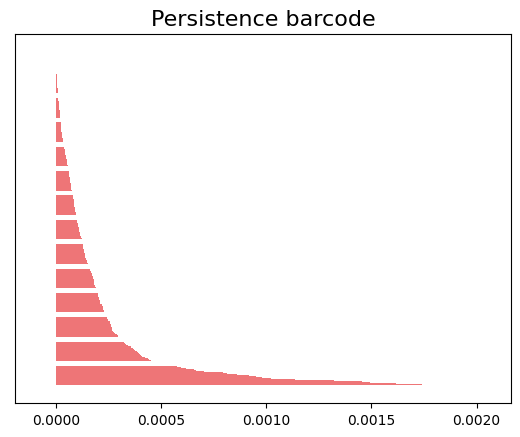

In [11]:
gd.plot_persistence_barcode(alpha_simplex_tree.persistence_intervals_in_dimension(0))
plt.show()

**Barcode vuoti dimensione 1**

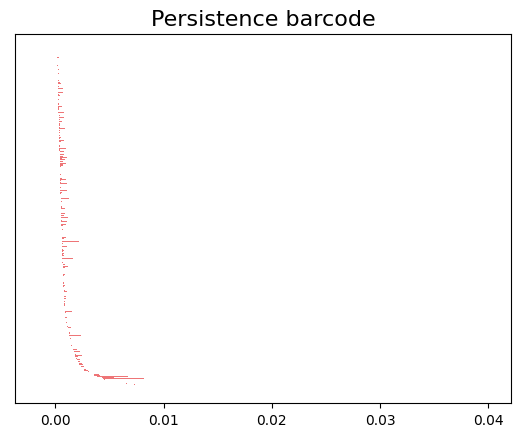

In [12]:
gd.plot_persistence_barcode(alpha_simplex_tree.persistence_intervals_in_dimension(1))
plt.show()

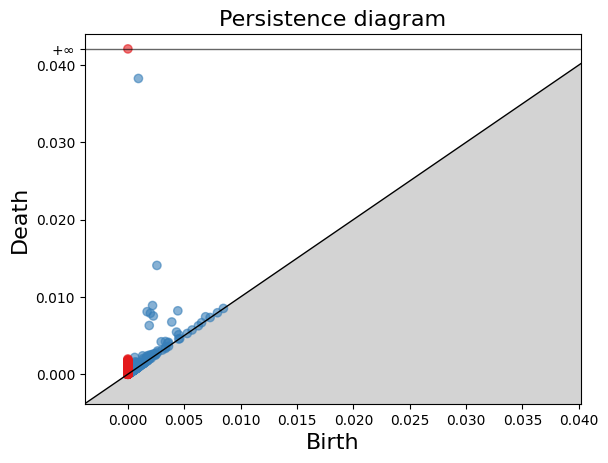

In [13]:
gd.plot_persistence_diagram(alpha_barcode)
plt.show()

### Vietoris-Rips complex

La scelta del parametro max_edge_length è motlo importante: ad esempio se =1 il complex ha 41.432.569 simplices mentre se =0.5 solo 4.991.234. Tuttavia l'omologia persistente delle due filtrazioni è esattamente la stessa.

In [14]:
# si noti che posso sfruttare in modo furbo ma_edge_length calcolando la distanza massima dei lati della rete
rips_skeleton = gd.RipsComplex(points = net2.vertices, max_edge_length = 0.5)
rips_simplex_tree = rips_skeleton.create_simplex_tree(max_dimension = 1) #triangoli pieni


In [26]:
rips_simplex_tree.dimension()
rips_simplex_tree.set_dimension(2)
rips_simplex_tree.dimension()

2

In [27]:
rips_simplex_tree.num_vertices()

686

In [28]:
rips_simplex_tree.num_simplices()

81903

Now let's compute the list of simplices in the Rips complex with the `get_filtration() ` function:

In [29]:
rips_generator = rips_simplex_tree.get_filtration()
#for simplex in rips_generator:
#    print(simplex)

#### Visualizzazione della filtrazione

In [30]:
_ = plot_simplicial_complex(
    net2.vertices,
    rips_simplex_tree,
    filtration_value=0.1,
    max_skeleton_order=10,
    segments_thickness = 1,
    segments_colour = 'red',
    points_thickness = 1,
    points_colour = 'black',
    show = True
)

#### Omologia persistente

In [31]:
rips_barcode = rips_simplex_tree.persistence()

**Barcode componeti connesse**

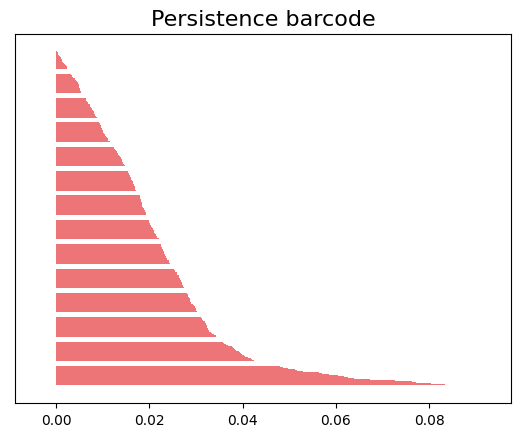

In [32]:
gd.plot_persistence_barcode(rips_simplex_tree.persistence_intervals_in_dimension(0))
plt.show()

**Barcode vuoti dimensione 1**

/usr/local/lib/python3.10/dist-packages/gudhi/persistence_graphical_tools.py:81: UserWarning:

There are 80532 intervals given as input, whereas max_intervals is set to 20000.



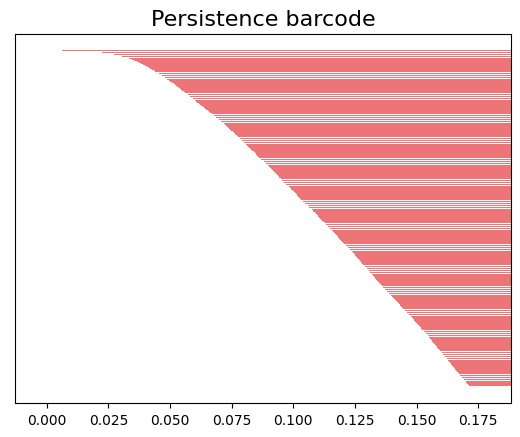

In [33]:
gd.plot_persistence_barcode(rips_simplex_tree.persistence_intervals_in_dimension(1))
plt.show()

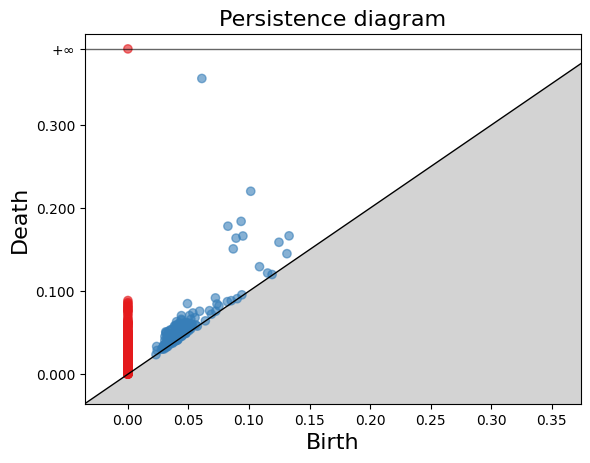

In [50]:
gd.plot_persistence_diagram(rips_barcode)
plt.show()

## User defined network

In [30]:
vertices = [[1,0,0],
           [1,0,1],
           [1,1,0],
           [1,1,1],
           [0,0,0],
           [0,0,1],
           [0,1,0],
           [0,1,1]]
vertices = np.array(vertices)
edges = [[0,1],
        [1,5],
        [5,0],
        [6,7]]
edges = np.array(edges)

net3 = Network(vertices, edges)
print(net3)

3-D network:
Number of vertices: 8
Number of edges: 4


In [31]:
_ = net3.plot(segments_thickness = 10,
            segments_color = 'black',
            vertices_thickness = 10,
            vertices_color = 'red',
            show = True)

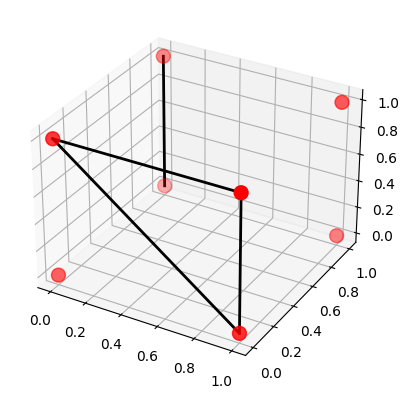

In [32]:
_ = net3.plot_static(segments_thickness = 2,
            segments_color = 'black',
            vertices_thickness = 100,
            vertices_color = 'red',
            show = True)

In [33]:
net_hom3= NetworkHomology(net3)
print(net_hom3)

Simplicial complex of dimension 1:
Number of simplices: 9
      5 of dimension 0
      4 of dimension 1
0 edges were discarded
0th Betti number: 2
1st Betti number: 1
Interpretation: the network is composed of 2 connected components and has 1 loops
